Análisis

IMprotamos las paqueterías necesarias

In [2]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import joblib

E importamos las herramientas a utilizar

In [3]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.feature_selection import VarianceThreshold
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import cross_val_score
from sklearn.neural_network import MLPRegressor
from sklearn.metrics import r2_score
from sklearn.metrics import mean_absolute_error
import lightgbm as lgb





Definimos el path del archivo

In [4]:
# Define the file path
file_path = '../data/finales/finales_data.csv'

Y cargamos el archivo con las variables limpias y solo las que nos intertesan

In [5]:
# Read the CSV file
data = pd.read_csv(open(file_path))

# Display the first few rows of the dataframe
print(data.head())

         Id  MSSubClass  LotFrontage   LotArea     Alley  OverallQual  \
0 -1.730865    0.073375     0.212877 -0.207142 -0.243025     0.651479   
1 -1.728492   -0.872563     0.645747 -0.091886 -0.243025    -0.071836   
2 -1.726120    0.073375     0.299451  0.073480 -0.243025     0.651479   
3 -1.723747    0.309859     0.068587 -0.096897 -0.243025     0.651479   
4 -1.721374    0.073375     0.761179  0.375148 -0.243025     1.374795   

   OverallCond  YearBuilt  YearRemodAdd  MasVnrType  ...  SaleType_ConLI  \
0    -0.517200   1.050994      0.878668    0.700875  ...       -0.058621   
1     2.179628   0.156734     -0.429577   -0.732287  ...       -0.058621   
2    -0.517200   0.984752      0.830215    0.700875  ...       -0.058621   
3    -0.517200  -1.863632     -0.720298   -0.732287  ...       -0.058621   
4    -0.517200   0.951632      0.733308    0.700875  ...       -0.058621   

   SaleType_ConLw  SaleType_New  SaleType_Oth  SaleType_WD  \
0       -0.058621     -0.301962     -0.045

Separamos la variable objetivo SalePrice de las demás

In [6]:
# Separar la variable objetivo (SalePrice)
X = data.drop(columns=['SalePrice'])  # Variables predictoras
y = data['SalePrice']  # Variable objetivo (SalePrice)

Dividimos nuestro data set 80% 20% en conjunto de prueba y de entrenamiento

In [ ]:
# Dividir los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

Como primero modelo proponemos un GradientBoostingRegressor

Root Mean Squared Error (RMSE): 28835.631824938075


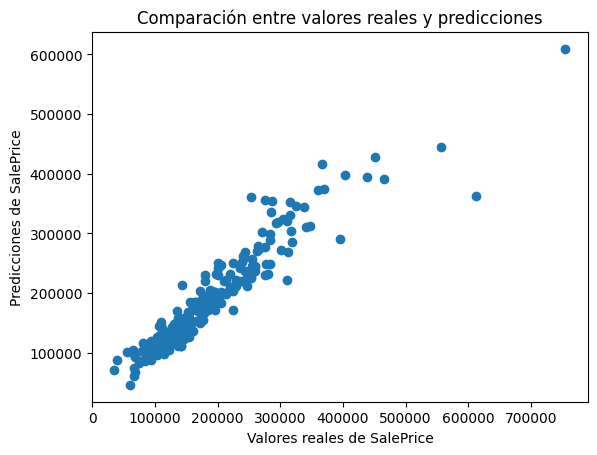

In [ ]:


# Inicializar el modelo de Gradient Boosting
model = GradientBoostingRegressor(n_estimators=100, learning_rate=0.1, max_depth=3, random_state=42)

# Entrenar el modelo
model.fit(X_train, y_train)

# Hacer predicciones
y_pred = model.predict(X_test)

# Evaluar el modelo
mse = mean_squared_error(y_test, y_pred)
rmse = mse ** 0.5  # Raíz cuadrada del error cuadrático medio
print(f"Root Mean Squared Error (RMSE): {rmse}")

# Graficar la comparación entre los valores reales y las predicciones
plt.scatter(y_test, y_pred)
plt.xlabel("Valores reales de SalePrice")
plt.ylabel("Predicciones de SalePrice")
plt.title("Comparación entre valores reales y predicciones")
plt.show()

Que nos dá un 28835.631824938075, que nos servirá como benchmarck para comparar con los modelos que se entrenarán a continuación.

Para mejorar el moedolo anterior, se utilizó un GridSearchCV, y después de muchas iteracciones, se encontró que los parámetros de búsqueda     'n_estimators': [ 150, 200, 250, ],
    'learning_rate': [0.01, 0.1, 0.2],
    'max_depth': [3, 5, 7] nos dan resultados desentes.

In [17]:
# Definir los parámetros para la búsqueda
param_grid = {
    'n_estimators': [ 150, 200, 250, ],
    'learning_rate': [0.01, 0.1, 0.2],
    'max_depth': [3, 5, 7]
}

# Inicializar GridSearchCV
grid_search = GridSearchCV(GradientBoostingRegressor(random_state=42), param_grid, cv=5, scoring='neg_mean_squared_error')

# Ajustar el modelo a los datos
grid_search.fit(X_train, y_train)

# Mostrar el mejor modelo encontrado
print(f"Mejores parámetros: {grid_search.best_params_}")
best_model = grid_search.best_estimator_

# Evaluar el modelo optimizado
y_pred_best = best_model.predict(X_test)
mse_best = mean_squared_error(y_test, y_pred_best)
rmse_best = mse_best ** 0.5
print(f"RMSE del modelo optimizado: {rmse_best}")

Mejores parámetros: {'learning_rate': 0.1, 'max_depth': 5, 'n_estimators': 250}
RMSE del modelo optimizado: 24873.62355174363
RMSE del modelo optimizado (log): 24873.62355174363


Los meores parámetros encontrados son: {'learning_rate': 0.1, 'max_depth': 5, 'n_estimators': 250}.Esto mejora nuestro modelo, dandonos un error medio cuadrado de  24873.62355174363 y

In [9]:
# Crear el modelo LightGBM
lgb_model = lgb.LGBMRegressor(random_state=42)

# Definir los parámetros para la búsqueda
param_grid = {
    'n_estimators': [50, 100, 150, 200, 250],
    'learning_rate': [0.01, 0.05, 0.1, 0.2],
    'max_depth': [3, 5, 7, 9],
    'num_leaves': [31, 50, 100],
    'subsample': [0.6, 0.8, 1.0]
}

# Inicializar GridSearchCV
grid_search = GridSearchCV(lgb_model, param_grid, cv=5, scoring='neg_mean_squared_error')

# Ajustar el modelo a los datos
grid_search.fit(X_train, y_train)

# Mostrar el mejor modelo encontrado
print(f"Mejores parámetros: {grid_search.best_params_}")
best_lgb_model = grid_search.best_estimator_

# Evaluar el modelo optimizado
y_pred_best_lgb = best_lgb_model.predict(X_test)

# Calcular el RMSE sobre los valores logarítmicos
mse_best_lgb = mean_squared_error(np.log(y_test), np.log(y_pred_best_lgb))
rmse_best_lgb = np.sqrt(mse_best_lgb)

print(f"RMSE del modelo LightGBM optimizado: {rmse_best_lgb}")


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003001 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3281
[LightGBM] [Info] Number of data points in the train set: 934, number of used features: 110
[LightGBM] [Info] Start training from score 181121.274090
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with posit

c:\Users\TABA\AppData\Local\Programs\Python\Python313\Lib\site-packages\joblib\externals\loky\backend\context.py:136: UserWarning: Could not find the number of physical cores for the following reason:
[WinError 2] El sistema no puede encontrar el archivo especificado
Returning the number of logical cores instead. You can silence this warning by setting LOKY_MAX_CPU_COUNT to the number of cores you want to use.
  warnings.warn(
  File "c:\Users\TABA\AppData\Local\Programs\Python\Python313\Lib\site-packages\joblib\externals\loky\backend\context.py", line 257, in _count_physical_cores
    cpu_info = subprocess.run(
        "wmic CPU Get NumberOfCores /Format:csv".split(),
        capture_output=True,
        text=True,
    )
  File "c:\Users\TABA\AppData\Local\Programs\Python\Python313\Lib\subprocess.py", line 554, in run
    with Popen(*popenargs, **kwargs) as process:
         ~~~~~^^^^^^^^^^^^^^^^^^^^^^
  File "c:\Users\TABA\AppData\Local\Programs\Python\Python313\Lib\subprocess.py", l

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

Lo cual, para los parámetros de {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 250, 'num_leaves': 31, 'subsample': 0.6}; nos dá un log RMSE del modelo LightGBM optimizado: 0.1392329269246963; el mejor hasta.


Finalmente, guardamos el modelo en ../modelo/

In [15]:
# Guardar el modelo
joblib.dump(best_model, '../modelo/modelo_optimizado.pkl')

print("Modelo guardado exitosamente en '../modelo/modelo_optimizado.pkl'")

Modelo guardado exitosamente en '../modelo/modelo_optimizado.pkl'
